In [1]:
%pip install matplotlib
%matplotlib inline

DEPRECATION: Loading egg at /Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/bladerf-1.3.0-py3.12.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [59]:
# Parámetros del canal
DIFS = 50  # μs
SIFS = 10  # μs
slot_time = 10 # μs
initial_CWmax = 2  # Valor inicial de CWmax
max_CWmax = 1024  # Valor máximo de CWmax
simulation_time = 100000  # Tiempo total de simulación en μs

# Parámetros de los nodos
num_nodes = 5  # Número de nodos en la red
packet_generation_rate = 0.0001  # Probabilidad de generar un paquete en un μs


In [60]:
class Node:
    def __init__(self, node_id):
        self.node_id = node_id
        self.CWmax = initial_CWmax
        self.backoff_time = 0
        self.waiting_DIFS = False
        self.waiting_SIFS = False
        self.DIFS_counter = DIFS
        self.SIFS_counter = SIFS
        self.has_packet = False
        self.successful_transmissions = 0
        self.collisions = 0

    def generate_packet(self):
        if not self.has_packet:
            self.has_packet = np.random.rand() < packet_generation_rate

    def update_backoff(self):
        self.backoff_time = np.random.randint(0, self.CWmax) * slot_time

    def reset_CW(self):
        self.CWmax = initial_CWmax

    def double_CW(self):
        self.CWmax = min(self.CWmax * 2, max_CWmax)


In [61]:
nodes = [Node(i) for i in range(num_nodes)]
time = 0
channel_busy = False
channel_end_time = 0

# Estadísticas
total_collisions = 0
total_successes = 0
time_line = []
throughput = []


In [62]:
while time < simulation_time:
    transmitting_nodes = []
    
    # Generación de paquetes en cada nodo
    for node in nodes:
        node.generate_packet()
        if node.has_packet:
            print(f"Tiempo {time}μs: Nodo {node.node_id} ha generado un paquete.")

    # Actualización de estados de los nodos
    for node in nodes:
        if node.has_packet:
            if not channel_busy:
                if not node.waiting_DIFS and not node.waiting_SIFS and node.backoff_time == 0:
                    node.waiting_DIFS = True
                    node.DIFS_counter = DIFS
                    print(f"Tiempo {time}μs: Nodo {node.node_id} inicia espera DIFS.")

                if node.waiting_DIFS:
                    node.DIFS_counter -= 1
                    print(f"Tiempo {time}μs: Nodo {node.node_id} esperando DIFS, restante {node.DIFS_counter}μs.")
                    if node.DIFS_counter <= 0:
                        node.waiting_DIFS = False
                        node.update_backoff()
                        print(f"Tiempo {time}μs: Nodo {node.node_id} terminó DIFS y selecciona backoff {node.backoff_time}μs.")

                elif node.backoff_time > 0:
                    node.backoff_time -= 1
                    print(f"Tiempo {time}μs: Nodo {node.node_id} en backoff, restante {node.backoff_time}μs.")
                    if node.backoff_time <= 0:
                        transmitting_nodes.append(node)
                        print(f"Tiempo {time}μs: Nodo {node.node_id} listo para transmitir.")
            else:
                print(f"Tiempo {time}μs: Nodo {node.node_id} detecta canal ocupado y espera.")

    # Manejo de transmisiones
    if transmitting_nodes:
        if len(transmitting_nodes) > 1:
            # Colisión
            total_collisions += 1
            print(f"Tiempo {time}μs: Colisión detectada entre {len(transmitting_nodes)} nodos.")
            for node in transmitting_nodes:
                node.collisions += 1
                node.double_CW()
                node.has_packet = True  # Reintentar transmisión
                node.update_backoff()
                print(f"Tiempo {time}μs: Nodo {node.node_id} duplica CWmax a {node.CWmax} y selecciona nuevo backoff {node.backoff_time}μs.")
            channel_busy = True
            channel_end_time = time + slot_time  # Supongamos que la colisión ocupa un slot de tiempo
        else:
            # Transmisión exitosa
            total_successes += 1
            node = transmitting_nodes[0]
            node.successful_transmissions += 1
            node.reset_CW()
            node.has_packet = False
            node.waiting_SIFS = True
            node.SIFS_counter = SIFS
            print(f"Tiempo {time}μs: Nodo {node.node_id} transmite con éxito. Se restablece CWmax a {node.CWmax}.")
            channel_busy = True
            channel_end_time = time + slot_time  # Tiempo de transmisión

    # Manejo del canal
    if channel_busy and time >= channel_end_time:
        channel_busy = False
        print(f"Tiempo {time}μs: El canal ahora está libre.")

    # Actualización del tiempo
    time += 1

    # Registro de estadísticas
    if time % 1000 == 0:
        time_line.append(time)
        throughput.append(total_successes / time * 1e6)  # Paquetes por segundo
        print(f"Estadísticas: Tiempo {time}μs, Éxitos acumulados: {total_successes}, Colisiones acumuladas: {total_collisions}.")


Estadísticas: Tiempo 1000μs, Éxitos acumulados: 0, Colisiones acumuladas: 0.
Tiempo 1671μs: Nodo 2 ha generado un paquete.
Tiempo 1671μs: Nodo 2 inicia espera DIFS.
Tiempo 1671μs: Nodo 2 esperando DIFS, restante 49μs.
Tiempo 1672μs: Nodo 2 ha generado un paquete.
Tiempo 1672μs: Nodo 2 esperando DIFS, restante 48μs.
Tiempo 1673μs: Nodo 2 ha generado un paquete.
Tiempo 1673μs: Nodo 2 esperando DIFS, restante 47μs.
Tiempo 1674μs: Nodo 2 ha generado un paquete.
Tiempo 1674μs: Nodo 2 esperando DIFS, restante 46μs.
Tiempo 1675μs: Nodo 2 ha generado un paquete.
Tiempo 1675μs: Nodo 2 esperando DIFS, restante 45μs.
Tiempo 1676μs: Nodo 2 ha generado un paquete.
Tiempo 1676μs: Nodo 2 esperando DIFS, restante 44μs.
Tiempo 1677μs: Nodo 2 ha generado un paquete.
Tiempo 1677μs: Nodo 2 esperando DIFS, restante 43μs.
Tiempo 1678μs: Nodo 2 ha generado un paquete.
Tiempo 1678μs: Nodo 2 esperando DIFS, restante 42μs.
Tiempo 1679μs: Nodo 2 ha generado un paquete.
Tiempo 1679μs: Nodo 2 esperando DIFS, resta

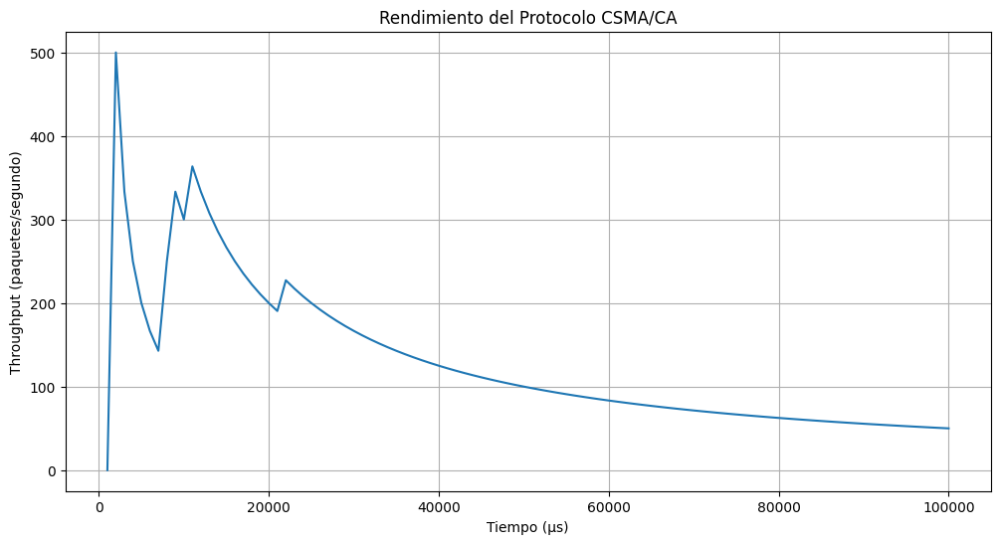

In [63]:
plt.figure(figsize=(12, 6))
plt.plot(time_line, throughput)
plt.title('Rendimiento del Protocolo CSMA/CA')
plt.xlabel('Tiempo (μs)')
plt.ylabel('Throughput (paquetes/segundo)')
plt.grid(True)
plt.show()
